In [8]:
!mkdir ./Model_nanoGPT
!ls

 data_processor.py	    model.py
 DataSet		    nanoEmbeddings.ipynb
 Data_Summary.ipynb	    nanoGPT
 eval.py		    nanoGPT-Copy1.ipynb
'Hate Speech Project.pdf'   nanoGPT.ipynb
 Model			    nanoGPT.ipynb.invalid
 Model_GPT		    __pycache__
 Model_GPT_tuned	    README.md
 Model_nanoGPT		    twitter-hate-speech-metadata.json
 model_Nano.py		    Various_Embeddings.ipynb
 Model_ndfd


In [2]:
import torch
import torch.nn as nn
print("CUDA available: ", torch.cuda.is_available())
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 

CUDA available:  True


Given that using NanoGPT is an obligatory part of your project, we can take an approach where we use NanoGPT for its intended purpose while trying to improve its performance as much as possible. One way to do this is to fine-tune NanoGPT on your specific task. While NanoGPT typically operates on a token-level, we can still leverage techniques to make it effective for sentence-level tasks like hate speech classification.

Here’s a detailed plan to use NanoGPT for your classification task:

1. Fine-Tune NanoGPT: Fine-tune NanoGPT on a dataset labeled for hate speech. This involves training NanoGPT on sequences where the task is to predict the next token in a way that it learns the context specific to hate speech.

2. Generate Embeddings Using Fine-Tuned NanoGPT: After fine-tuning, use NanoGPT to generate embeddings for your text. You can use the hidden states of the model as embeddings.

3. Classification Using the Embeddings: Use the generated embeddings to train a classifier for hate speech detection.

In [3]:
import importlib
import warnings
warnings.filterwarnings("ignore")

import os
current_directory = os.getcwd()
print(current_directory)

import time
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from jupyterthemes import jtplot
jtplot.style(theme="monokai", context="notebook", ticks=True, grid=True)
import seaborn as sns

%load_ext autoreload
%autoreload 2

train_df = pd.read_csv('./DataSet/train_df.csv', index_col=0)
train_df

/home/lucy/Documents/MachineLearning/HateSpeech


,label,tweet,length
id,,,
1,0,when a father is dysfunctional and is so selfi...,93
2,0,thanks for lyft credit i cant use cause they d...,104
3,0,bihday your majesty,19
4,0,model i love u take with u all the time in ur,47
5,0,factsguide society now motivation,36
...,...,...,...
31958,0,ate isz that youuu?,20
31959,0,to see nina turner on the airwaves trying to w...,126
31960,0,listening to sad songs on a monday morning otw...,61


### Fine-Tune NanoGPT

number of parameters: 29.95M


Epoch 1: 100%|████████████| 2557/2557 [1:07:01<00:00,  1.57s/batch, loss=0.0965]


Epoch 1 Average Training Loss: 0.5052
Epoch 1 Average Validation Loss: 0.0537


Epoch 2: 100%|█████████████| 2557/2557 [1:14:34<00:00,  1.75s/batch, loss=0.026]


Epoch 2 Average Training Loss: 0.0480
Epoch 2 Average Validation Loss: 0.0129


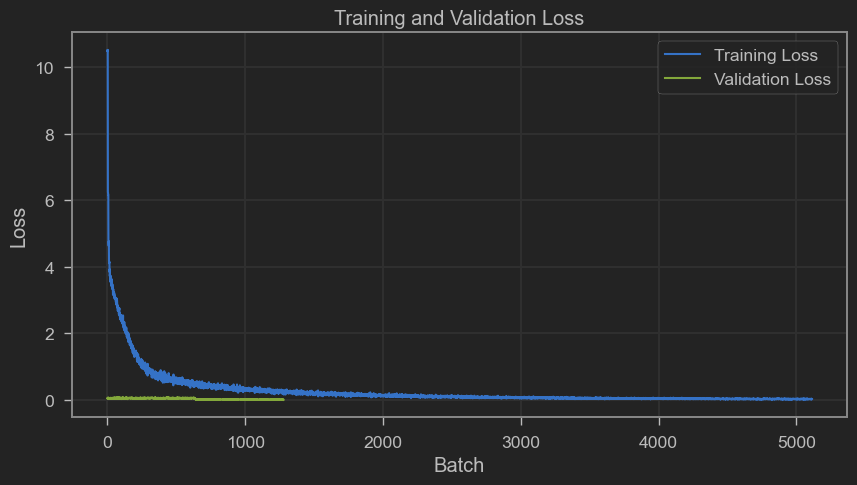

In [3]:
import os
import torch
import numpy as np
from torch.utils.data import DataLoader, Dataset, random_split
from transformers import GPT2Tokenizer
from model_Nano import GPT, GPTConfig
from tqdm import tqdm
import torch.cuda.amp as amp
import matplotlib.pyplot as plt

# Define your dataset class
class TweetDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_length=256):
        self.texts = [str(text) for text in texts if text is not None]  # Ensure all texts are strings and non-null
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_length = max_length

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        inputs = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_length,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )
        input_ids = inputs['input_ids'].squeeze()
        return input_ids, torch.tensor(label, dtype=torch.long)

# Initialize the tokenizer
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
if tokenizer.pad_token is None:
    tokenizer.add_special_tokens({'pad_token': tokenizer.eos_token})

# Prepare the data
# Ensure the text data does not contain any NaN values
train_df['tweet'] = train_df['tweet'].fillna('')
train_texts = train_df['tweet'].tolist()  # Your training texts
train_labels = train_df['label'].tolist()  # Your training labels

# Create the dataset
dataset = TweetDataset(train_texts, train_labels, tokenizer)

# Remove empty sequences from the dataset
dataset = [item for item in dataset if len(item[0]) > 0]

# Split the dataset into train and validation sets
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create the DataLoader
batch_size = 10  # Adjust based on your GPU memory
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Initialize the nanoGPT model with the provided hyperparameters
config = GPTConfig(
    vocab_size=tokenizer.vocab_size,
    block_size=256,  # Ensure this matches the input sequence length
    n_layer=6,
    n_head=12,
    n_embd=384,
    dropout=0.2
)
model = GPT(config)

# Ensure the model runs on GPU if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model.to(device)

# Training setup
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, betas=(0.9, 0.99))
criterion = torch.nn.CrossEntropyLoss()

# Gradient accumulation steps
accumulation_steps = 4  # Simulate a batch size of 8 * 2 = 16

# Mixed precision setup
scaler = amp.GradScaler()

# Lists to store training and validation losses for each batch
train_losses = []
val_losses = []

# Training loop with hyperparameters
for epoch in range(2):  # Train for 3 epochs
    model.train()
    epoch_loss = 0
    with tqdm(train_dataloader, unit="batch") as tepoch:
        for i, batch in enumerate(tepoch):
            tepoch.set_description(f"Epoch {epoch + 1}")

            input_ids, labels = batch

            # Move batch tensors to the same device as the model
            input_ids = input_ids.to(device)
            labels = labels.to(device)

            with amp.autocast():
                # Forward pass
                logits, loss = model(input_ids, targets=input_ids)

                # Normalize the loss to the effective batch size
                loss = loss / accumulation_steps

            # Backward pass with mixed precision
            scaler.scale(loss).backward()

            if (i + 1) % accumulation_steps == 0:
                scaler.step(optimizer)
                scaler.update()
                optimizer.zero_grad()

            epoch_loss += loss.item() * accumulation_steps
            train_losses.append(loss.item() * accumulation_steps)
            tepoch.set_postfix(loss=loss.item() * accumulation_steps)

    avg_epoch_loss = epoch_loss / len(train_dataloader)
    print(f"Epoch {epoch + 1} Average Training Loss: {avg_epoch_loss:.4f}")

    # Validation loop
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch in val_dataloader:
            input_ids, labels = batch
            input_ids = input_ids.to(device)
            labels = labels.to(device)
            with amp.autocast():
                logits, loss = model(input_ids, targets=input_ids)
                val_loss += loss.item()
                val_losses.append(loss.item())

    avg_val_loss = val_loss / len(val_dataloader)
    print(f"Epoch {epoch + 1} Average Validation Loss: {avg_val_loss:.4f}")

# Save the fine-tuned model
os.makedirs('./Model_nanoGPT', exist_ok=True)
torch.save(model.state_dict(), './Model_nanoGPT/fine_tuned_nano_gpt.pth')

# Plot training and validation loss
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Batch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()


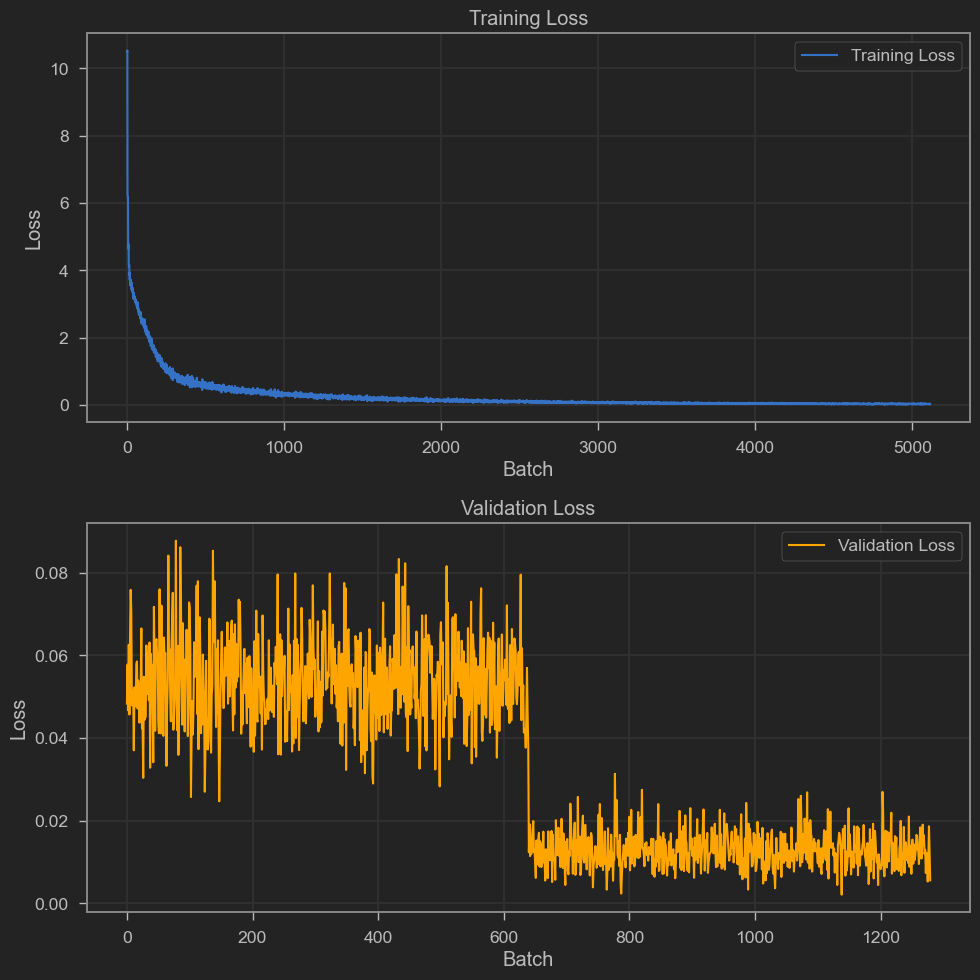

In [6]:
# Plot training and validation loss
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 10))

ax1.plot(train_losses, label='Training Loss')
ax1.set_xlabel('Batch')
ax1.set_ylabel('Loss')
ax1.set_title('Training Loss')
ax1.legend()

ax2.plot(val_losses, label='Validation Loss', color='orange')
ax2.set_xlabel('Batch')
ax2.set_ylabel('Loss')
ax2.set_title('Validation Loss')
ax2.legend()

plt.tight_layout()
plt.show()

# Generate Embeddings Using Fine-Tuned NanoGPT


In [5]:
import os
import torch
import numpy as np
from tqdm import tqdm
from transformers import GPT2Tokenizer
from model_Nano import GPT, GPTConfig
from torch.utils.data import DataLoader, Dataset
import torch.cuda.amp as amp

# Define your dataset class
class TweetDataset(Dataset):
    def __init__(self, texts, tokenizer, max_length=256):
        self.texts = [str(text) for text in texts if text is not None]  # Ensure all texts are strings and non-null
        self.tokenizer = tokenizer
        self.max_length = max_length

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        inputs = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_length,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )
        input_ids = inputs['input_ids'].squeeze()
        attention_mask = inputs['attention_mask'].squeeze()
        return input_ids, attention_mask

# Initialize the tokenizer
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
if tokenizer.pad_token is None:
    tokenizer.add_special_tokens({'pad_token': tokenizer.eos_token})

# Prepare the data
train_texts = train_df['tweet'].tolist()  # Your training texts

# Create the dataset and DataLoader
dataset = TweetDataset(train_texts, tokenizer)
batch_size = 64  # Adjust batch size to fit GPU memory constraints
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=4)

# Initialize the fine-tuned NanoGPT model
config = GPTConfig(
    vocab_size=tokenizer.vocab_size,
    block_size=256,  # Ensure this matches the input sequence length
    n_layer=6,
    n_head=12,
    n_embd=384,
    dropout=0.2
)
model = GPT(config)

# Load the fine-tuned model weights
model.load_state_dict(torch.load('./Model_nanoGPT/fine_tuned_nano_gpt.pth'))
model.to('cuda' if torch.cuda.is_available() else 'cpu')
model.eval()

# Attention mechanism for pooling
class AttentionPooling(torch.nn.Module):
    def __init__(self, input_dim):
        super(AttentionPooling, self).__init__()
        self.attention = torch.nn.Linear(input_dim, 1)

    def forward(self, hidden_states, attention_mask):
        with torch.cuda.amp.autocast(enabled=False):  # Disable AMP for this operation
            hidden_states = hidden_states.float()  # Ensure hidden states are in float32
            attention_scores = self.attention(hidden_states).squeeze(-1)
            attention_scores = attention_scores.masked_fill(attention_mask == 0, -1e9)
            attention_weights = torch.nn.functional.softmax(attention_scores, dim=1)
            weighted_hidden_states = hidden_states * attention_weights.unsqueeze(-1)
            pooled_output = weighted_hidden_states.sum(dim=1)
        return pooled_output

attention_pooling = AttentionPooling(config.n_embd).to('cuda' if torch.cuda.is_available() else 'cpu')

# Function to perform hybrid pooling (max pooling + attention pooling)
def hybrid_pooling(hidden_states, attention_mask):
    mask = attention_mask.unsqueeze(-1).expand_as(hidden_states).float()
    hidden_states = hidden_states * mask
    max_embeddings = torch.max(hidden_states, dim=1).values
    attn_embeddings = attention_pooling(hidden_states, attention_mask)
    hybrid_embeddings = torch.cat((max_embeddings, attn_embeddings), dim=1)
    return hybrid_embeddings

# Define pooling strategies
pooling_strategies = {
    'attention_mean': 'Attention Mean Pooling',
    'attention_cls': 'Attention CLS Token Pooling',
    'attention_max': 'Attention Max Pooling',
    'attention_weighted': 'Attention Weighted Pooling',
    'attention_hybrid': 'Attention Hybrid Pooling'
}

# Generate embeddings for each strategy
for strategy, description in pooling_strategies.items():
    all_embeddings = []
    print(f"Generating embeddings using {description}...")
    
    for batch in tqdm(dataloader):
        input_ids, attention_mask = batch
        input_ids = input_ids.to('cuda' if torch.cuda.is_available() else 'cpu')
        attention_mask = attention_mask.to('cuda' if torch.cuda.is_available() else 'cpu')
        
        with torch.no_grad():
            with amp.autocast():
                logits, hidden_states = model(input_ids, return_hidden_states=True)  # Ensure the model returns the correct hidden states
                if strategy == 'attention_mean':
                    # Mean pooling (excluding padded tokens)
                    mask = attention_mask.unsqueeze(-1).expand(hidden_states.size()).float()
                    sum_embeddings = torch.sum(hidden_states * mask, 1)
                    sum_mask = torch.clamp(mask.sum(1), min=1e-9)
                    batch_embeddings = (sum_embeddings / sum_mask).cpu().numpy()
                elif strategy == 'attention_cls':
                    # CLS token pooling
                    batch_embeddings = hidden_states[:, 0, :].cpu().numpy()
                elif strategy == 'attention_max':
                    # Max pooling (excluding padded tokens)
                    mask = attention_mask.unsqueeze(-1).expand(hidden_states.size()).float()
                    hidden_states = hidden_states * mask
                    batch_embeddings = torch.max(hidden_states, dim=1).values.cpu().numpy()
                elif strategy == 'attention_weighted':
                    # Weighted pooling
                    weights = attention_mask.float() / attention_mask.sum(dim=1, keepdim=True)
                    weights = weights.unsqueeze(-1).expand(hidden_states.size())
                    batch_embeddings = (hidden_states * weights).sum(dim=1).cpu().numpy()
                elif strategy == 'attention_hybrid':
                    # Hybrid pooling
                    batch_embeddings = hybrid_pooling(hidden_states, attention_mask).cpu().numpy()
                
                all_embeddings.append(batch_embeddings)
    
    # Concatenate all batch embeddings
    abstract_embeddings = np.concatenate(all_embeddings, axis=0)
    
    # Save the generated embeddings
    embeddings_save_path = f'./Model_nanoGPT/gpt2_{strategy}/embeddings.npy'
    os.makedirs(os.path.dirname(embeddings_save_path), exist_ok=True)
    np.save(embeddings_save_path, abstract_embeddings)
    print(f"Embeddings saved to {embeddings_save_path}")

    # Normalize the embeddings
    norms = np.linalg.norm(abstract_embeddings, axis=1, keepdims=True)
    norms[norms == 0] = 1e-10
    normalized_embeddings = abstract_embeddings / norms
    normalized_embeddings_save_path = f'./Model_nanoGPT/gpt2_{strategy}/normalized_embeddings_{strategy}.npy'
    np.save(normalized_embeddings_save_path, normalized_embeddings)
    print(f"Normalized embeddings saved to {normalized_embeddings_save_path}")


number of parameters: 29.95M
Generating embeddings using Attention Mean Pooling...


100%|█████████████████████████████████████████| 500/500 [08:26<00:00,  1.01s/it]


Embeddings saved to ./Model_nanoGPT/gpt2_attention_mean/embeddings.npy
Normalized embeddings saved to ./Model_nanoGPT/gpt2_attention_mean/normalized_embeddings_attention_mean.npy
Generating embeddings using Attention CLS Token Pooling...


100%|█████████████████████████████████████████| 500/500 [11:00<00:00,  1.32s/it]


Embeddings saved to ./Model_nanoGPT/gpt2_attention_cls/embeddings.npy
Normalized embeddings saved to ./Model_nanoGPT/gpt2_attention_cls/normalized_embeddings_attention_cls.npy
Generating embeddings using Attention Max Pooling...


100%|█████████████████████████████████████████| 500/500 [12:40<00:00,  1.52s/it]


Embeddings saved to ./Model_nanoGPT/gpt2_attention_max/embeddings.npy
Normalized embeddings saved to ./Model_nanoGPT/gpt2_attention_max/normalized_embeddings_attention_max.npy
Generating embeddings using Attention Weighted Pooling...


100%|█████████████████████████████████████████| 500/500 [10:48<00:00,  1.30s/it]


Embeddings saved to ./Model_nanoGPT/gpt2_attention_weighted/embeddings.npy
Normalized embeddings saved to ./Model_nanoGPT/gpt2_attention_weighted/normalized_embeddings_attention_weighted.npy
Generating embeddings using Attention Hybrid Pooling...


100%|█████████████████████████████████████████| 500/500 [12:41<00:00,  1.52s/it]


Embeddings saved to ./Model_nanoGPT/gpt2_attention_hybrid/embeddings.npy
Normalized embeddings saved to ./Model_nanoGPT/gpt2_attention_hybrid/normalized_embeddings_attention_hybrid.npy


In [6]:
import os
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score

# Define the base path for the normalized embeddings files
base_path = './Model_nanoGPT/'
# Define the different pooling strategies
pooling_strategies = ['attention_mean', 'attention_cls', 'attention_max', 'attention_weighted', 'attention_hybrid']

# Loop over each pooling strategy
for strategy in pooling_strategies:
    normalized_embeddings_save_path = os.path.join(base_path, f'gpt2_{strategy}/normalized_embeddings_{strategy}.npy')
    
    # Check if the normalized embeddings file exists
    if os.path.exists(normalized_embeddings_save_path):
        print(f"Processing embeddings for strategy: {strategy}")
        
        # Load the normalized embeddings
        normalized_embeddings = np.load(normalized_embeddings_save_path)
        labels = train_df['label'].values  # Assuming 'label' is the column name for labels in train_df

        # Split the data into train and test sets
        X_train, X_test, y_train, y_test = train_test_split(normalized_embeddings, labels, test_size=0.2, random_state=42)

        # Train a logistic regression classifier
        clf = LogisticRegression(max_iter=1000)
        clf.fit(X_train, y_train)

        # Make predictions on the test set
        y_pred = clf.predict(X_test)

        # Evaluate the classifier
        accuracy = accuracy_score(y_test, y_pred)
        report = classification_report(y_test, y_pred)

        # Print the results
        print(f"Accuracy for {strategy} pooling: {accuracy}")
        print(f"Classification Report for {strategy} pooling:\n{report}")

    else:
        print(f"Normalized embeddings file not found for strategy {strategy}: {normalized_embeddings_save_path}")

Processing embeddings for strategy: attention_mean
Accuracy for attention_mean pooling: 0.9314875645236977
Classification Report for attention_mean pooling:
              precision    recall  f1-score   support

           0       0.93      1.00      0.96      5937
           1       0.80      0.05      0.10       456

    accuracy                           0.93      6393
   macro avg       0.87      0.53      0.53      6393
weighted avg       0.92      0.93      0.90      6393

Processing embeddings for strategy: attention_cls
Accuracy for attention_cls pooling: 0.9319568277803848
Classification Report for attention_cls pooling:
              precision    recall  f1-score   support

           0       0.93      1.00      0.96      5937
           1       0.92      0.05      0.10       456

    accuracy                           0.93      6393
   macro avg       0.93      0.53      0.53      6393
weighted avg       0.93      0.93      0.90      6393

Processing embeddings for strategy:

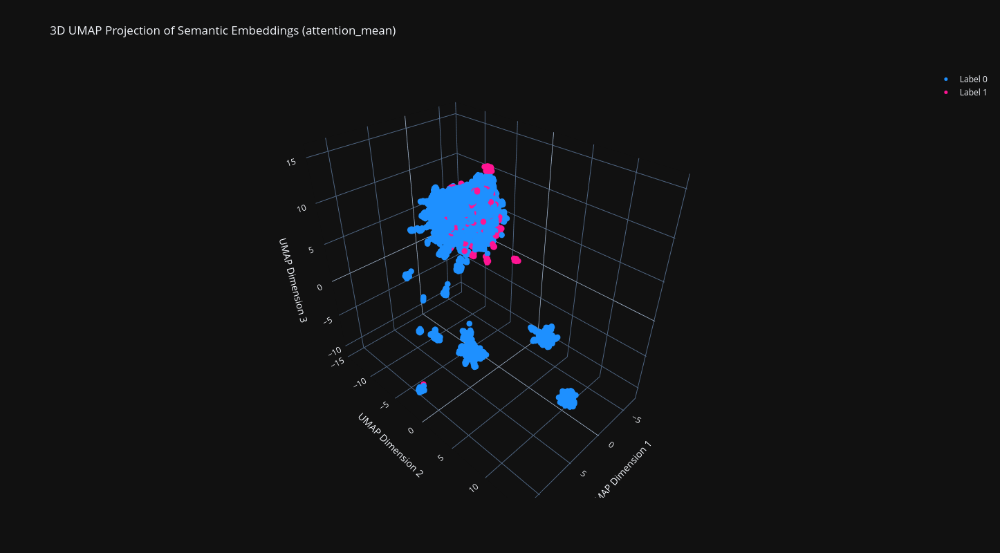

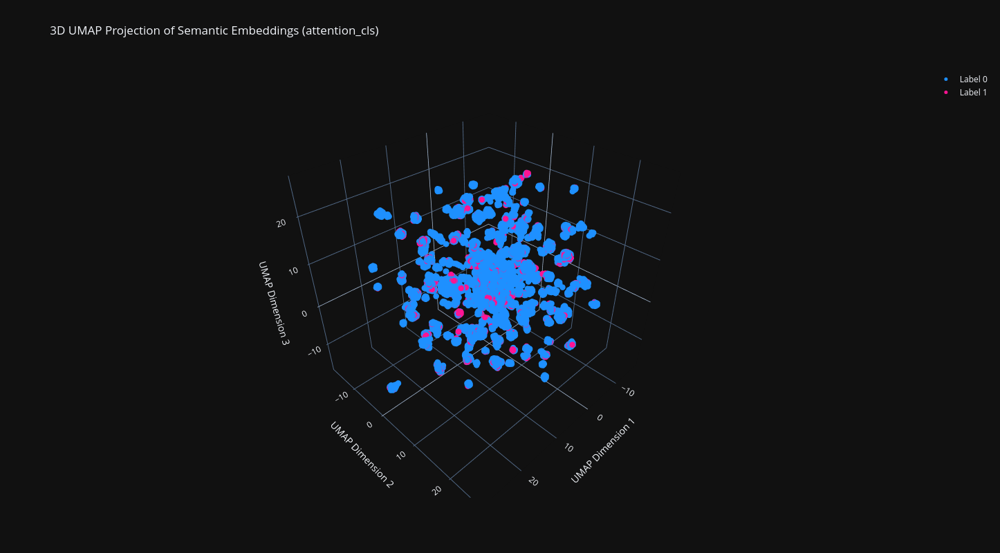

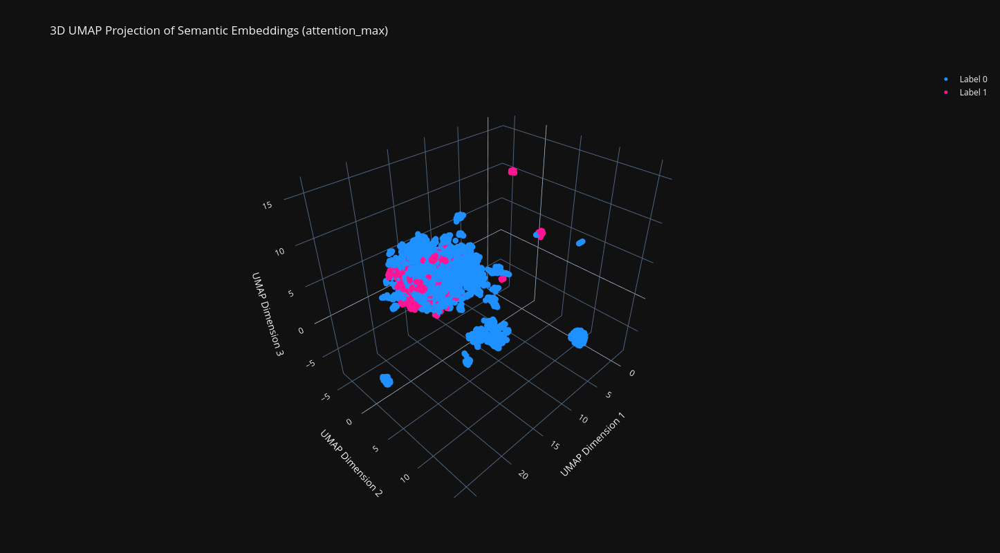

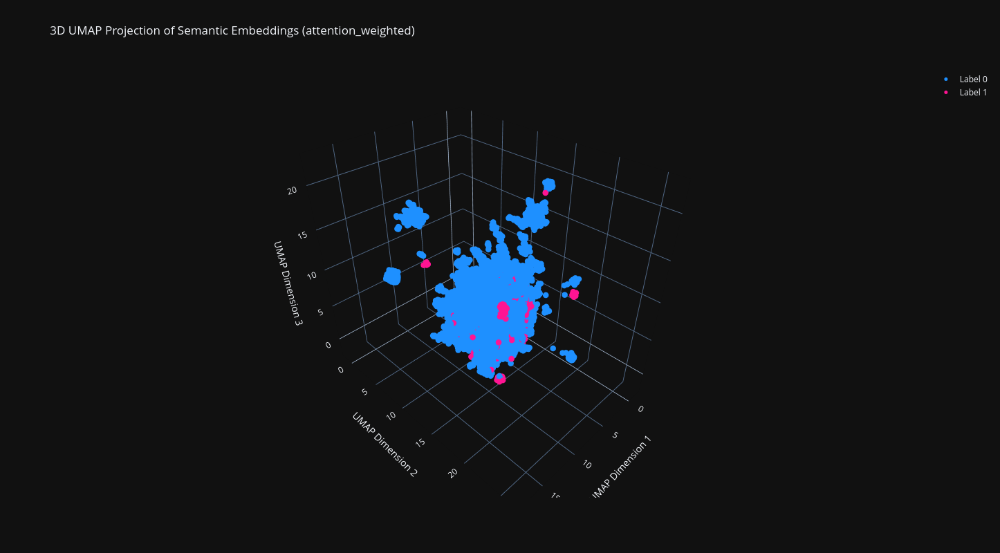

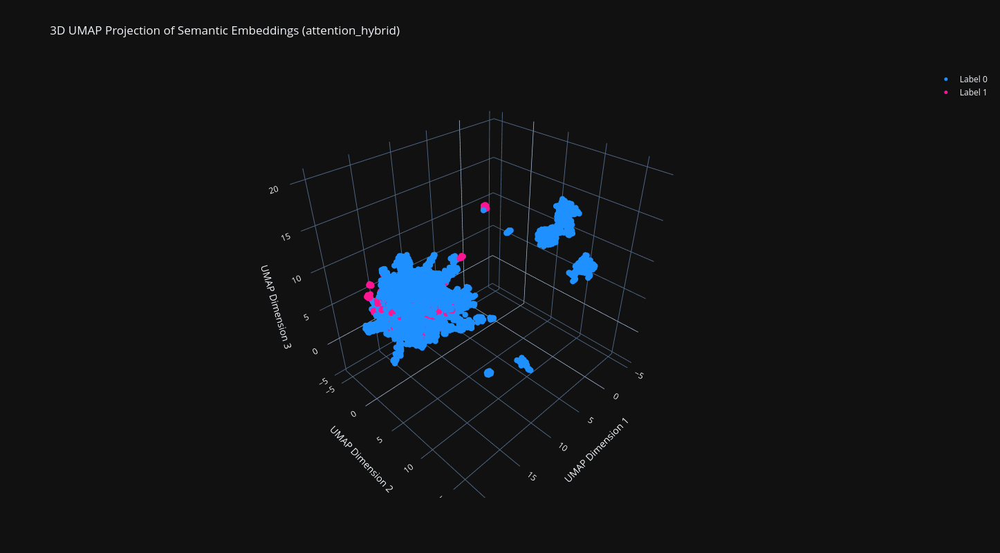

In [7]:
import os
import numpy as np
import umap
import plotly.express as px
import plotly.graph_objects as go

def analyze_embeddings_mark(df, embeddings, strategy_name, n_neighbors=40, min_dist=0.9, n_components=3, random_state=42):
    # Check for NaNs in embeddings
    if np.isnan(embeddings).any():
        raise ValueError("The embeddings array contains NaN values.")

    # Ensure the DataFrame and embeddings array have matching lengths
    if len(df) != embeddings.shape[0]:
        raise ValueError("The length of DataFrame and embeddings array do not match.")

    # Reset index to ensure continuous indices
    df = df.reset_index(drop=True)

    # Dimensionality Reduction with UMAP
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=random_state)
    umap_embeddings = reducer.fit_transform(embeddings)

    # Custom color map
    custom_colors = {0: 'dodgerblue', 1: 'deeppink'}

    # Create a scatter plot
    fig = go.Figure()

    for label in df['label'].unique():
        label_indices = df[df['label'] == label].index
        fig.add_trace(go.Scatter3d(
            x=umap_embeddings[label_indices, 0],
            y=umap_embeddings[label_indices, 1],
            z=umap_embeddings[label_indices, 2],
            mode='markers',
            marker=dict(
                size=5,
                color=custom_colors[label]
            ),
            name=f"Label {label}"
        ))

    fig.update_layout(
        title=f"3D UMAP Projection of Semantic Embeddings ({strategy_name})",
        scene=dict(
            xaxis_title="UMAP Dimension 1",
            yaxis_title="UMAP Dimension 2",
            zaxis_title="UMAP Dimension 3"
        ),
        template='plotly_dark',
        height=800,
        width=1000
    )

    return fig

# Define the base path for the normalized embeddings files
base_path = './Model_nanoGPT/'
# Define the different pooling strategies
pooling_strategies = ['attention_mean', 'attention_cls', 'attention_max', 'attention_weighted', 'attention_hybrid']

# Loop over each pooling strategy
for strategy in pooling_strategies:
    normalized_embeddings_save_path = os.path.join(base_path, f'gpt2_{strategy}/normalized_embeddings_{strategy}.npy')
    
    # Check if the normalized embeddings file exists
    if os.path.exists(normalized_embeddings_save_path):
        # Load the normalized embeddings
        normalized_embeddings = np.load(normalized_embeddings_save_path)
        
        # Analyze and visualize embeddings
        fig = analyze_embeddings_mark(train_df, embeddings=normalized_embeddings, strategy_name=strategy, n_neighbors=40, min_dist=0.9, n_components=3)
        fig.show()
    else:
        print(f"Normalized embeddings file not found for strategy {strategy}: {normalized_embeddings_save_path}")


Based on the classification reports and accuracy metrics for each embedding strategy, the attention_cls strategy appears to be the best among the ones tested. Here’s a summary of the results for each strategy:

1. Attention Mean Pooling:

Accuracy: 0.9315
F1-score for label 0: 0.96
F1-score for label 1: 0.10

2. Attention CLS Token Pooling:

Accuracy: 0.9320
F1-score for label 0: 0.96
F1-score for label 1: 0.10

3. Attention Max Pooling:

Accuracy: 0.9287
F1-score for label 0: 0.96
F1-score for label 1: 0.00

4. Attention Weighted Pooling:

Accuracy: 0.9315
F1-score for label 0: 0.96
F1-score for label 1: 0.10

5. Attention Hybrid Pooling:

Accuracy: 0.9287
F1-score for label 0: 0.96
F1-score for label 1: 0.00

Key Observations:
Attention CLS Token Pooling has the highest accuracy (0.9320) and performs better than others in terms of precision and recall for label 1, although the improvement is minimal.
Attention Mean and Weighted Pooling also perform well, but their accuracy is slightly lower than attention_cls.
Attention Max and Hybrid Pooling have the same accuracy (0.9287), which is lower than the other strategies, and they both have poor F1-scores for label 1.

Conclusion:
Given the accuracy and F1-scores, Attention CLS Token Pooling is the best embedding strategy among the ones tested. It provides the highest accuracy and relatively better performance for label 1 compared to other strategies.

Next Steps:
Further Improvements: we could explore additional methods like Transformer-based sentence embeddings, BERT-based embeddings, or leveraging multi-head attention mechanisms to potentially improve classification performance.
Data Augmentation: Increase the diversity and size of your dataset, especially for the minority class, to improve model generalization.
Fine-tuning Hyperparameters: Adjust hyperparameters such as learning rate, batch size, and the number of layers/heads in your model for better performance.
By implementing these steps, we can further enhance the performance and robustness of your classification model.